## Generate Data Book Figures

In this notebook, the Waveform plots and Mel Spectrograms for the data book are generated. Specifically, the difference is that these plots have annotations such as axes and titles. 

In [104]:
import numpy as np
from glob import glob
import librosa 
import matplotlib.pyplot as plt
import pandas as pd
import pylab
import librosa.display

In [105]:
def get_mel_annotated(y, sr, class_name, count):
    # generate the spectrogram
    time = np.arange(0, len(y)) / sr
    S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)
    # plot 
    fig, ax = plt.subplots()
    S_dB = librosa.power_to_db(S, ref=np.max)
    img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
    
    #fig.colorbar(img, ax=ax, format='%+2.0f dB')
    ax.set(title='Mel-frequency spectrogram')
    
    # save the spectrogram to the correct location 
    name_path = "databook/Mel-Spectrograms/" + str(class_name) + "/" + str(count) + ".png" 
    plt.savefig(name_path)

In [106]:
def get_waveform(y, sr, class_name, count):
    time = np.arange(0, len(y)) / sr
    fig, ax = plt.subplots()
    ax.plot(time, y)
    ax.set(xlabel='Time (seconds)', ylabel='Amplitude') 
    ax.set(title='Waveform')
    #plt.show()
    
    # save the plot 
    name_path = "databook/Waveforms/" + str(class_name) + "/" + str(count) + ".png"
    plt.savefig(name_path)

### Iterate, generate, and save

In [107]:
import os
directory = 'wavfiles'

In [108]:
master_dict = {}
for subdir in os.listdir(directory):
    path = directory + "/" + subdir
    d = glob(path + '/*.wav')
    master_dict[subdir] = d

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


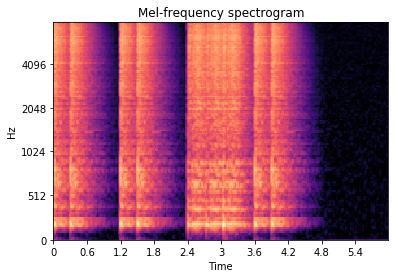

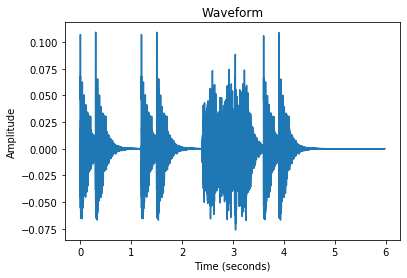

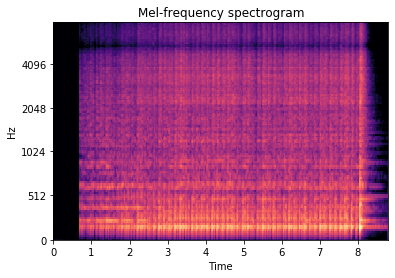

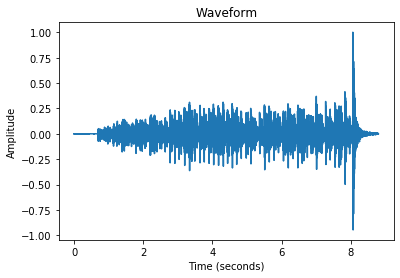

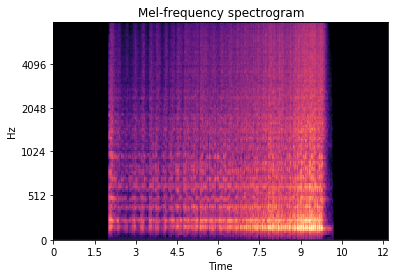

...

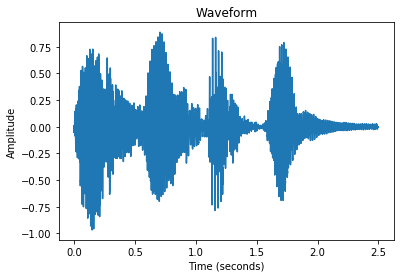

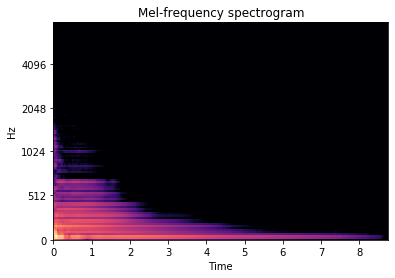

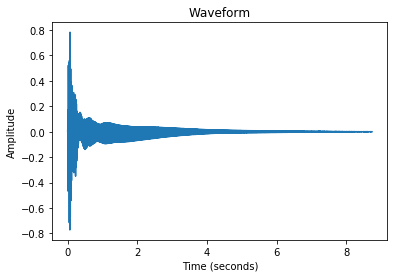

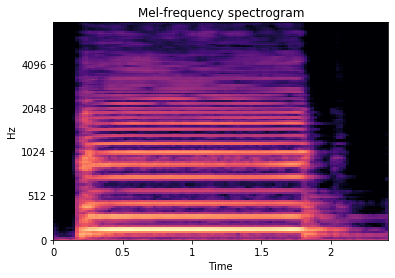

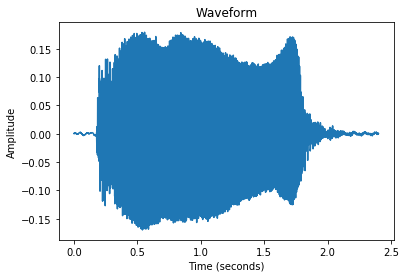

In [111]:
for key in master_dict:
    class_name = key
    class_list = master_dict[key]
    count = 0
    for file in class_list:
        count += 1
        y, sr = librosa.load(file)
        get_mel_annotated(y, sr, class_name, count)
        get_waveform(y, sr, class_name, count)